In [1]:
import pandas as pd
import numpy as np
import os
## Rest
from scipy.fftpack import fft
from scipy import signal
from scipy.io import wavfile
from tqdm import tqdm
import matplotlib.pyplot as plt
import IPython.display as ipd



In [2]:
file_meta=pd.read_csv('iemocap_meta.csv')

In [3]:
import librosa
import librosa.display

In [4]:
file_meta.id[0].split('_')

['Ses01F', 'impro01', 'F000']

In [5]:
filename=file_meta.path_to_wav[0]+'_'.join(file_meta.id[0].split('_')[:-1])+".wav"


In [6]:
samples, sample_rate = librosa.load(filename)
                                    
                                    

In [7]:
sample_rate, samples

(22050,
 array([ 0.42572615,  0.37312022, -0.21554364, ..., -0.5133006 ,
        -0.3152705 ,  0.        ], dtype=float32))

In [8]:
def log_specgram(audio, sample_rate, window_size=20,
                 step_size=10, eps=1e-10):
    nperseg = int(round(window_size * sample_rate / 1e3))
    noverlap = int(round(step_size * sample_rate / 1e3))
    freqs, times, spec = signal.spectrogram(audio,
                                    fs=sample_rate,
                                    window='hann',
                                    nperseg=nperseg,
                                    noverlap=noverlap,
                                    detrend=False)
    return freqs, times, np.log(spec.T.astype(np.float32) + eps)

Text(0.5, 0, 'Seconds')

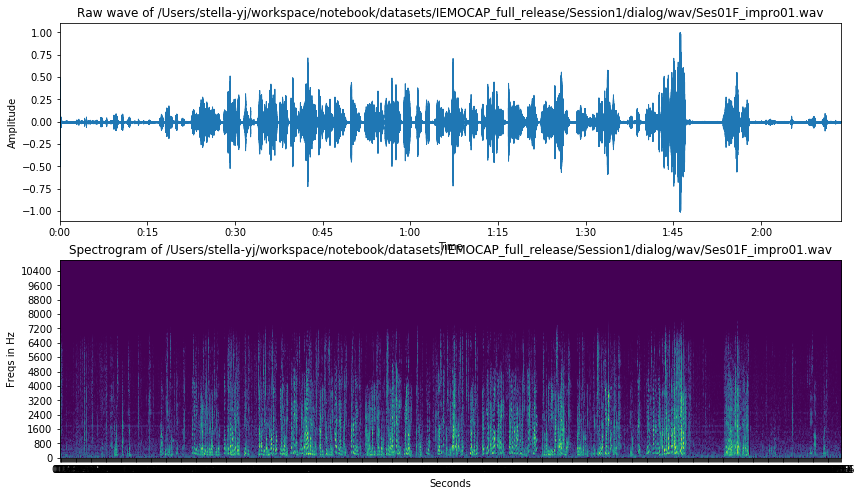

In [9]:
# Plotting Wave Form and Spectrogram
freqs, times, spectrogram = log_specgram(samples, sample_rate)

fig = plt.figure(figsize=(14, 8))
ax1 = fig.add_subplot(211)
ax1.set_title('Raw wave of ' + filename)
ax1.set_ylabel('Amplitude')
librosa.display.waveplot(samples, sr=sample_rate)

ax2 = fig.add_subplot(212)
ax2.imshow(spectrogram.T, aspect='auto', origin='lower', 
           extent=[times.min(), times.max(), freqs.min(), freqs.max()])
ax2.set_yticks(freqs[::16])
ax2.set_xticks(times[::16])
ax2.set_title('Spectrogram of ' + filename)
ax2.set_ylabel('Freqs in Hz')
ax2.set_xlabel('Seconds')

In [10]:
mean = np.mean(spectrogram, axis=0)
std = np.std(spectrogram, axis=0)
spectrogram = (spectrogram - mean) / std

In [11]:
# Trim the silence voice
aa , bb = librosa.effects.trim(samples, top_db=30)
aa, bb

(array([ 0.42572615,  0.37312022, -0.21554364, ..., -0.5133006 ,
        -0.3152705 ,  0.        ], dtype=float32),
 array([      0, 2946458]))

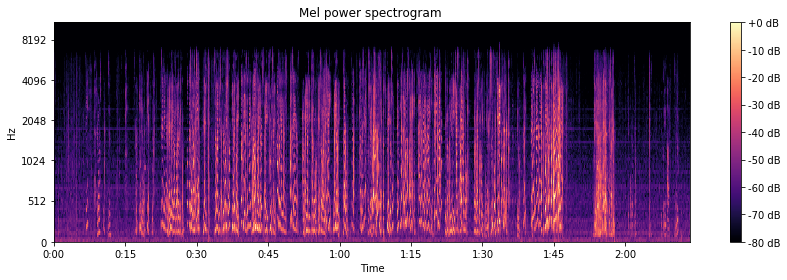

In [12]:
# Plotting Mel Power Spectrogram
S = librosa.feature.melspectrogram(aa, sr=sample_rate, n_mels=128)

# Convert to log scale (dB). We'll use the peak power (max) as reference.
log_S = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize=(12, 4))
librosa.display.specshow(log_S, sr=sample_rate, x_axis='time', y_axis='mel')
plt.title('Mel power spectrogram ')
plt.colorbar(format='%+02.0f dB')
plt.tight_layout()

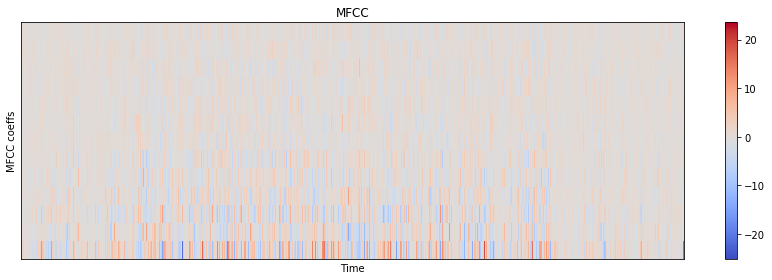

In [13]:
# Plotting MFCC
mfcc = librosa.feature.mfcc(S=log_S, n_mfcc=13)

# Let's pad on the first and second deltas while we're at it
delta2_mfcc = librosa.feature.delta(mfcc, order=2)

plt.figure(figsize=(12, 4))
librosa.display.specshow(delta2_mfcc)
plt.ylabel('MFCC coeffs')
plt.xlabel('Time')
plt.title('MFCC')
plt.colorbar()
plt.tight_layout()


In [14]:
# Original Sound
ipd.Audio(samples, rate=sample_rate)

In [15]:
ipd.Audio(aa, rate=sample_rate)

In [16]:
# Silence trimmed Sound by manuel trimming
samples_cut = samples[10000:-12500]
ipd.Audio(samples_cut, rate=sample_rate)

In [17]:
file_meta.start[0]

6.2901

In [18]:
from pydub import AudioSegment

/Users/stella-yj/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/pydub/utils.py:165: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


In [19]:
dialog = AudioSegment.from_wav(filename)


In [20]:
cutted=dialog[file_meta.start[0]*1000:file_meta.end[0]*1000]

In [21]:
cutted.export("cutted.wav", format='wav')

<_io.BufferedRandom name='cutted.wav'>

In [22]:
root_path=os.path.dirname(os.path.realpath('.'))

In [23]:
for i in range(file_meta.shape[0]):
    file_name=file_meta.path_to_wav[i]+'_'.join(file_meta.id[i].split('_')[:-1])+".wav"
    dialog=AudioSegment.from_wav(file_name)
    cutted=dialog[file_meta.start[i]*1000:file_meta.end[i]*1000]
    cutted_path=root_path+'/datasets/IEMOCAP_CUTTED/'+file_meta.id[i]+'.wav'
    cutted.export(cutted_path, format='wav')

/Users/stella-yj/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/pydub/utils.py:193: RuntimeWarning: Couldn't find ffprobe or avprobe - defaulting to ffprobe, but may not work
  warn("Couldn't find ffprobe or avprobe - defaulting to ffprobe, but may not work", RuntimeWarning)


FileNotFoundError: [Errno 2] No such file or directory: 'ffprobe': 'ffprobe'

In [24]:
samples, sample_rate = librosa.load(root_path+'/datasets/IEMOCAP_CUTTED/'+file_meta.id[0]+'.wav')

In [25]:
sample_rate

22050

Text(0.5, 0, 'Seconds')

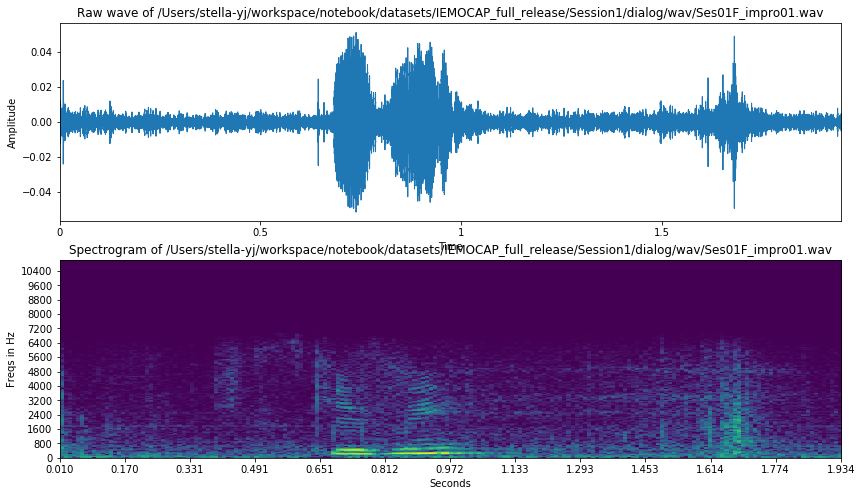

In [26]:
# Plotting Wave Form and Spectrogram
freqs, times, spectrogram = log_specgram(samples, sample_rate)

fig = plt.figure(figsize=(14, 8))
ax1 = fig.add_subplot(211)
ax1.set_title('Raw wave of ' + filename)
ax1.set_ylabel('Amplitude')
librosa.display.waveplot(samples, sr=sample_rate)

ax2 = fig.add_subplot(212)
ax2.imshow(spectrogram.T, aspect='auto', origin='lower', 
           extent=[times.min(), times.max(), freqs.min(), freqs.max()])
ax2.set_yticks(freqs[::16])
ax2.set_xticks(times[::16])
ax2.set_title('Spectrogram of ' + filename)
ax2.set_ylabel('Freqs in Hz')
ax2.set_xlabel('Seconds')

In [27]:
mean = np.mean(spectrogram, axis=0)
std = np.std(spectrogram, axis=0)
spectrogram = (spectrogram - mean) / std

In [28]:
# Trim the silence voice
aa , bb = librosa.effects.trim(samples, top_db=30)
aa, bb

(array([-0.00070661, -0.00308682, -0.00480553, ..., -0.00380395,
        -0.00218341,  0.        ], dtype=float32),
 array([    0, 42902]))

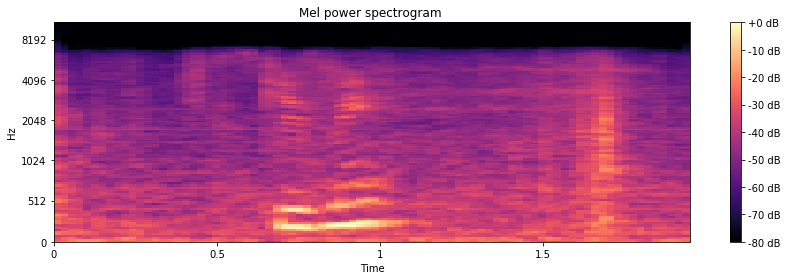

In [29]:
# Plotting Mel Power Spectrogram
S = librosa.feature.melspectrogram(aa, sr=sample_rate, n_mels=128)

# Convert to log scale (dB). We'll use the peak power (max) as reference.
log_S = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize=(12, 4))
librosa.display.specshow(log_S, sr=sample_rate, x_axis='time', y_axis='mel')
plt.title('Mel power spectrogram ')
plt.colorbar(format='%+02.0f dB')
plt.tight_layout()

In [30]:
log_S

array([[-24.316654, -24.523674, -23.214302, ..., -22.122026, -22.461826,
        -25.252193],
       [-29.033663, -25.444468, -21.649664, ..., -20.363846, -22.766867,
        -24.355677],
       [-30.315355, -26.025696, -24.856796, ..., -29.278343, -30.305294,
        -27.045645],
       ...,
       [-78.49071 , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ],
       [-78.586426, -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ],
       [-78.64775 , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ]], dtype=float32)

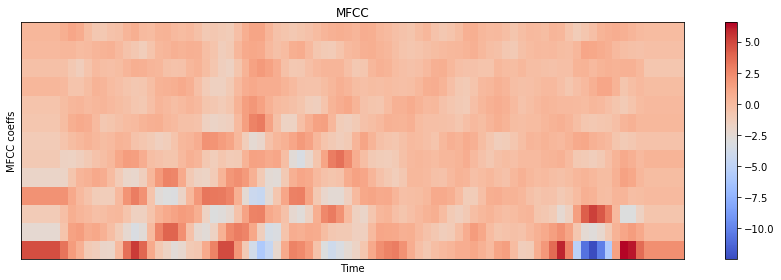

In [31]:
# Plotting MFCC
mfcc = librosa.feature.mfcc(S=log_S, n_mfcc=13)

# Let's pad on the first and second deltas while we're at it
delta2_mfcc = librosa.feature.delta(mfcc, order=2)

plt.figure(figsize=(12, 4))
librosa.display.specshow(delta2_mfcc)
plt.ylabel('MFCC coeffs')
plt.xlabel('Time')
plt.title('MFCC')
plt.colorbar()
plt.tight_layout()

In [32]:
ipd.Audio(samples, rate=sample_rate)

In [33]:
ipd.Audio(aa, rate=sample_rate)

In [34]:
# Silence trimmed Sound by manuel trimming
samples_cut = samples[10000:-12500]
ipd.Audio(samples_cut, rate=sample_rate)

In [35]:
file_meta

,start,end,id,v,a,d,emotion,emo_evo,signal,transcription,path_to_wav
0,6.2901,8.2357,Ses01F_impro01_F000,2.5,2.5,2.5,neu,"[['neu'], ['neu'], ['neu'], ['neu']]",[-165 -163 -125 ... -104 -137 -146],Excuse me.,/Users/stella-yj/workspace/notebook/datasets/I...
1,10.0100,11.3925,Ses01F_impro01_F001,2.5,2.5,2.5,neu,"[['neu'], ['neu'], ['neu'], ['neu', 'ang']]",[-31 -23 -18 ... -42 -27 -12],Yeah.,/Users/stella-yj/workspace/notebook/datasets/I...
2,14.8872,18.0175,Ses01F_impro01_F002,2.5,2.5,2.5,neu,"[['neu'], ['sur'], ['neu'], ['neu', 'ang']]",[-12 -5 14 ... -6 29 41],Is there a problem?,/Users/stella-yj/workspace/notebook/datasets/I...
3,27.4600,31.4900,Ses01F_impro01_F005,2.5,3.5,2.0,neu,"[['neu'], ['fru', 'ang'], ['neu'], ['neu']]",[-28 -41 -55 ... 90 77 57],Well what's the problem? Let me change it.,/Users/stella-yj/workspace/notebook/datasets/I...
4,85.2700,88.0200,Ses01F_impro01_F012,2.0,3.5,3.5,ang,"[['ang'], ['dis'], ['ang'], ['fru', 'sur', 'an...",[452 387 229 ... -20 -13 -6],That's out of control.,/Users/stella-yj/workspace/notebook/datasets/I...
...,...,...,...,...,...,...,...,...,...,...,...
4931,236.5700,244.8300,Ses05M_script03_2_M041,1.0,4.5,5.0,ang,"[['ang'], ['ang'], ['ang']]",[ -23 -28 -24 ... 224 825 1143],"You are a vile tempered, wicked living, evil l...",/Users/stella-yj/workspace/notebook/datasets/I...
4932,244.8400,246.5800,Ses05M_script03_2_M042,1.0,4.5,4.5,ang,"[['ang'], ['ang'], ['ang']]",[ -83 -51 -142 ... 253 259 299],"Oh, you're not going like this.",/Users/stella-yj/workspace/notebook/datasets/I...
4933,246.5900,248.8300,Ses05M_script03_2_M043,1.5,4.0,4.5,ang,"[['ang'], ['ang'], ['ang']]",[-1025 -629 -577 ... 29 -8 4],"[GARBAGE] No, you're not.",/Users/stella-yj/workspace/notebook/datasets/I...
4934,255.8600,260.3300,Ses05M_script03_2_M044,1.0,5.0,5.0,ang,"[['ang'], ['ang'], ['ang']]",[13443 13536 13754 ... -54 -417 -232],oh! Marry you again? I wouldn't marry you agai...,/Users/stella-yj/workspace/notebook/datasets/I...


In [36]:
file_meta.emotion.unique()

array(['neu', 'ang', 'sad', 'exc'], dtype=object)

In [37]:
file_meta.id[0].split('_')[2][0]

'F'

In [38]:
cutted_file_meta=file_meta[['id', 'transcription', 'emotion']]

In [39]:
cutted_file_meta['gender']=cutted_file_meta['id'].apply(lambda x: x.split('_')[-1][0])

/Users/stella-yj/.pyenv/versions/anaconda3-5.3.1/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [40]:
cutted_file_meta

,id,transcription,emotion,gender
0,Ses01F_impro01_F000,Excuse me.,neu,F
1,Ses01F_impro01_F001,Yeah.,neu,F
2,Ses01F_impro01_F002,Is there a problem?,neu,F
3,Ses01F_impro01_F005,Well what's the problem? Let me change it.,neu,F
4,Ses01F_impro01_F012,That's out of control.,ang,F
...,...,...,...,...
4931,Ses05M_script03_2_M041,"You are a vile tempered, wicked living, evil l...",ang,M
4932,Ses05M_script03_2_M042,"Oh, you're not going like this.",ang,M
4933,Ses05M_script03_2_M043,"[GARBAGE] No, you're not.",ang,M
4934,Ses05M_script03_2_M044,oh! Marry you again? I wouldn't marry you agai...,ang,M


In [41]:
cutted_file_meta.gender.unique()

array(['F', 'M'], dtype=object)

## get feature

In [42]:
data=pd.DataFrame(columns=['feature'])

In [44]:
for i in tqdm(range(cutted_file_meta.shape[0])):
    file_path='../datasets/IEMOCAP_CUTTED/'+cutted_file_meta.id[i]+'.wav'
    X, sample_rate=librosa.load(file_path, 
                                res_type='kaiser_fast',
                                sr=22050*2,
                                offset=0.5)
    sample_rate=np.array(sample_rate)
    mfccs = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13), axis=0)
    feature = mfccs
    data.loc[i] = [feature]

100%|██████████| 4936/4936 [04:00<00:00, 20.53it/s]


In [45]:
data

,feature
0,"[-27.189535, -26.149937, -24.601765, -25.45449..."
1,"[-23.883333, -25.308868, -28.661163, -25.96919..."
2,"[-26.36517, -23.994616, -24.649982, -25.157488..."
3,"[-28.205454, -26.451023, -24.569359, -25.09575..."
4,"[-9.327277, -12.116719, -14.43122, -14.993114,..."
...,...
4931,"[-16.806953, -17.698992, -19.244442, -20.89036..."
4932,"[-2.961821, -7.133197, -18.843697, -18.938103,..."
4933,"[-17.402952, -14.982385, -11.122619, -11.27163..."
4934,"[-17.89075, -18.916975, -19.135128, -18.77083,..."


In [47]:
df3 = pd.DataFrame(data['feature'].values.tolist())
df3.head()

,0,1,2,3,4,5,6,7,8,9,...,2888,2889,2890,2891,2892,2893,2894,2895,2896,2897
0,-27.189535,-26.149937,-24.601765,-25.454496,-26.484652,-25.043741,-24.073936,-23.464260,-23.722332,-25.224422,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-23.883333,-25.308868,-28.661163,-25.969194,-27.838758,-23.990252,-21.962337,-22.804981,-24.742218,-23.021639,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,-26.365170,-23.994616,-24.649982,-25.157488,-25.022631,-23.667194,-23.587748,-25.736105,-25.176090,-26.486050,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,-28.205454,-26.451023,-24.569359,-25.095755,-24.643801,-23.384121,-27.125803,-27.349215,-24.080090,-21.341398,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,-9.327277,-12.116719,-14.431220,-14.993114,-15.962012,-16.081240,-17.258726,-18.691069,-17.933865,-17.445372,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [48]:
df3=df3.fillna(0)

In [49]:
df3.to_csv('feature.csv', index=False)